![pandas-profiling](https://pandas-profiling.github.io/pandas-profiling/docs/assets/logo_header.png "pandas-profiling image")

# pandas-profilingを用いた探索的データ分析
![pandas-profiling](https://pandas-profiling.github.io/pandas-profiling/docs/assets/logo_header.png "pandas-profiling image")
参考ページ: 
https://qiita.com/wakame1367/items/39faf5d91e20a5cf5772  
（Google Colabに対応させるために追加でパッケージを読み込ませているが、Jupyter上で実行する分にはなくても警告は出ないかもしれない。）

公式: 
https://pandas-profiling.github.io/pandas-profiling/docs/master/index.html  
https://github.com/pandas-profiling/pandas-profiling

In [2]:
import pandas as pd
import warnings
from pandas_profiling import ProfileReport
from pandas_profiling.utils.cache import cache_file

warnings.filterwarnings('ignore')

file_name = cache_file(
    "titanic.csv",
    "https://raw.githubusercontent.com/datasciencedojo/datasets/master/titanic.csv",
)
df = pd.read_csv(file_name)
profile = ProfileReport(df)

profile

結果をHTML形式で出力させる。  
（JSON形式で保存する場合は、 拡張子.htmlから.jsonに変更する。）

In [5]:
profile.to_file("./titanic_report_by_pandas-profiling.html")

In [3]:
df.describe()

,PassengerId,Survived,Pclass,Age,SibSp,Parch,Fare
count,891.000000,891.000000,891.000000,714.000000,891.000000,891.000000,891.000000
mean,446.000000,0.383838,2.308642,29.699118,0.523008,0.381594,32.204208
std,257.353842,0.486592,0.836071,14.526497,1.102743,0.806057,49.693429
min,1.000000,0.000000,1.000000,0.420000,0.000000,0.000000,0.000000
25%,223.500000,0.000000,2.000000,20.125000,0.000000,0.000000,7.910400
50%,446.000000,0.000000,3.000000,28.000000,0.000000,0.000000,14.454200
75%,668.500000,1.000000,3.000000,38.000000,1.000000,0.000000,31.000000
max,891.000000,1.000000,3.000000,80.000000,8.000000,6.000000,512.329200


# dataprep でEDAを行う
pandas-profilingとほぼ同等の機能があるが、欠損値・欠測値の可視化の部分でより詳細な検討が可能である。 
ただし、ローカル環境に導入する場合、パッケージの依存関係などがシビアで厄介な面がある。  
公式ドキュメント: https://sfu-db.github.io/dataprep/index.html 
公式repo: https://github.com/sfu-db/dataprep

![dataprep](https://github.com/sfu-db/dataprep/raw/develop/assets/logo.png "dataprep")

In [1]:
import pandas as pd
df = pd.read_csv("https://www.openml.org/data/get_csv/16826755/phpMYEkMl", na_values = ['?'])

In [2]:
from dataprep.eda import *

NumExpr defaulting to 8 threads.



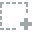
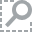
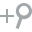
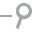
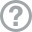
...
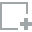
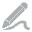
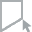
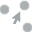
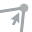

In [5]:
plot(df)

In [6]:
plot_correlation(df)


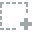
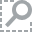
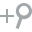
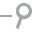
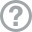
...
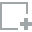
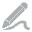
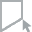
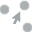
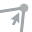

In [7]:
plot_missing(df)

In [9]:
df.all()

pclass        True
survived     False
name          True
sex           True
age           True
sibsp        False
parch        False
ticket        True
fare         False
cabin         True
embarked      True
boat          True
body          True
home.dest     True
dtype: bool


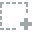
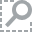
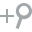
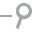
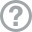
...
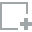
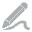
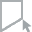
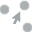
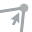

In [10]:
# identify 'PassengerId','Survived', 'Pclass' as categorical column and replot.
for col in ['survived', 'pclass']:
    df[col] = df[col].astype("object")
plot(df)

In [27]:
df

,pclass,survived,name,sex,age,sibsp,parch,ticket,fare,cabin,embarked,boat,body,home.dest
0,1,1,"Allen, Miss. Elisabeth Walton",female,29.0000,0,0,24160,211.3375,B5,S,2,NaN,"St Louis, MO"
1,1,1,"Allison, Master. Hudson Trevor",male,0.9167,1,2,113781,151.5500,C22 C26,S,11,NaN,"Montreal, PQ / Chesterville, ON"
2,1,0,"Allison, Miss. Helen Loraine",female,2.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
3,1,0,"Allison, Mr. Hudson Joshua Creighton",male,30.0000,1,2,113781,151.5500,C22 C26,S,NaN,135.0,"Montreal, PQ / Chesterville, ON"
4,1,0,"Allison, Mrs. Hudson J C (Bessie Waldo Daniels)",female,25.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1304,3,0,"Zabour, Miss. Hileni",female,14.5000,1,0,2665,14.4542,NaN,C,NaN,328.0,NaN
1305,3,0,"Zabour, Miss. Thamine",female,NaN,1,0,2665,14.4542,NaN,C,NaN,NaN,NaN
1306,3,0,"Zakarian, Mr. Mapriededer",male,26.5000,0,0,2656,7.2250,NaN,C,NaN,304.0,NaN
1307,3,0,"Zakarian, Mr. Ortin",male,27.0000,0,0,2670,7.2250,NaN,C,NaN,NaN,NaN


In [11]:
import sys
print(sys.version)

3.7.7 (default, Mar 26 2020, 10:32:53) 
[Clang 4.0.1 (tags/RELEASE_401/final)]


In [12]:
import dataprep
print(dataprep.__version__) 

0.2.14



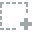
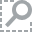
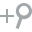
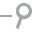
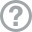
...
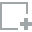
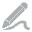
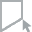
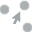
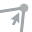

In [16]:
plot_missing(df, 'age')


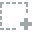
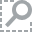
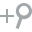
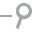
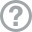
...
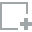
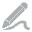
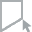
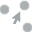
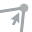

In [18]:
plot_missing(df, 'cabin')


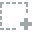
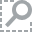
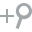
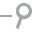
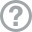
...
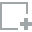
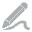
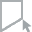
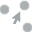
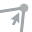

In [19]:
plot_missing(df, 'body')

In [21]:
df

,pclass,survived,name,sex,age,sibsp,parch,ticket,fare,cabin,embarked,boat,body,home.dest
0,1,1,"Allen, Miss. Elisabeth Walton",female,29.0000,0,0,24160,211.3375,B5,S,2,NaN,"St Louis, MO"
1,1,1,"Allison, Master. Hudson Trevor",male,0.9167,1,2,113781,151.5500,C22 C26,S,11,NaN,"Montreal, PQ / Chesterville, ON"
2,1,0,"Allison, Miss. Helen Loraine",female,2.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
3,1,0,"Allison, Mr. Hudson Joshua Creighton",male,30.0000,1,2,113781,151.5500,C22 C26,S,NaN,135.0,"Montreal, PQ / Chesterville, ON"
4,1,0,"Allison, Mrs. Hudson J C (Bessie Waldo Daniels)",female,25.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1304,3,0,"Zabour, Miss. Hileni",female,14.5000,1,0,2665,14.4542,NaN,C,NaN,328.0,NaN
1305,3,0,"Zabour, Miss. Thamine",female,NaN,1,0,2665,14.4542,NaN,C,NaN,NaN,NaN
1306,3,0,"Zakarian, Mr. Mapriededer",male,26.5000,0,0,2656,7.2250,NaN,C,NaN,304.0,NaN
1307,3,0,"Zakarian, Mr. Ortin",male,27.0000,0,0,2670,7.2250,NaN,C,NaN,NaN,NaN


In [7]:
from dataprep.eda import create_report
df2 = pd.read_csv("https://raw.githubusercontent.com/datasciencedojo/datasets/master/titanic.csv")
report = create_report(df2, title = 'report_titanic_by_dataprep_')

In [8]:
# report.show_browser()

In [6]:
report.save(filename='report_titanic_by_dataprep', to='./')

Report has been saved to ./report_titanic_by_dataprep.html!


DataPrep Report
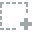
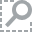
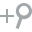
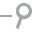
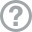
...
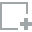
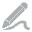
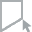
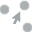
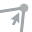

In [4]:
report

![dataprep vs. pandas-profiling](https://ichi.pro/assets/images/max/724/1*638Gb1wSwYQZmf_alMUjxg.png "dataprep_vs_others image")

In [23]:
create_report

<function dataprep.eda.create_report.create_report(df: pandas.core.frame.DataFrame, title: Union[str, NoneType] = 'DataPrep Report', mode: Union[str, NoneType] = 'basic', progress: bool = True) -> dataprep.eda.create_report.io.Report>

In [37]:
dataprep.eda.create_report(df).show_browser()

KeyError: 0

In [31]:
create_report(df).show_browser()

KeyError: 0

In [50]:
plot_missing

<function dataprep.eda.missing.plot_missing(df: Union[pandas.core.frame.DataFrame, dask.dataframe.core.DataFrame], x: Union[str, NoneType] = None, y: Union[str, NoneType] = None, *, bins: int = 20, ndist_sample: int = 100, dtype: Union[Dict[str, Union[dataprep.eda.dtypes.DType, Type[dataprep.eda.dtypes.DType], str]], dataprep.eda.dtypes.DType, Type[dataprep.eda.dtypes.DType], NoneType] = None, progress: bool = True) -> dataprep.eda.container.Container>

In [49]:
plot_missing(df0)

ValueError: The truth value of a Index is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().